ECUACIÓN DE SCHRODINGER DEPENDIENTE DEL TIEMPO: MÉTODO DE CRANCK NICOLSON, ALPHA DECAY.

In [25]:
import numpy as np
from scipy.sparse import diags
from scipy.sparse.linalg import splu
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter 
from matplotlib import animation
from IPython.display import HTML
import matplotlib as mpl

Definición de constantes y parámetros de la simulación.

In [26]:
# Parámetros espaciales
N = 5000          # número de puntos espaciales
L=100.0 #fm
x = np.linspace(0, L, N) #discretización del dominio
h = x[1]-x[0]

hbarc=197.327 #(MeV)
u = 931.494 #(MeV/c^2)
malfa = 4*u #partícula alfa
# NUCLEOS
NumA_polonio=212
NumA_uranio=238
NumA_actinio=227
NumA_radon=222
NumA_polonio2=218

mhijo_polonio=(NumA_polonio - 4)*u #plomo (núcleo hijo del Polonio 212: Plomo 208)
mhijo_uranio=(NumA_uranio - 4)*u #plomo (núcleo hijo del Uranio 238: Torio 234)
mhijo_actinio=(NumA_actinio - 4)*u #plomo (núcleo hijo del Actinio 227: Torio 223)
mhijo_radon=(NumA_radon - 4)*u #plomo (núcleo hijo del Radón 222: Polonio 218)
mhijo_polonio2 = (NumA_polonio2 - 4)*u  # Plomo-210


mu_polonio=(malfa*mhijo_polonio)/(malfa+mhijo_polonio) #masa reducida
mu_uranio=(malfa*mhijo_uranio)/(malfa+mhijo_uranio)
mu_actinio=(malfa*mhijo_actinio)/(malfa+mhijo_actinio)
mu_radon=(malfa*mhijo_radon)/(malfa+mhijo_radon)
mu_polonio2=(malfa*mhijo_polonio2)/(malfa+mhijo_polonio2)

print("Masa reducida (Polonio 212):",mu_polonio)
print("Masa reducida (Uranio 238):",mu_uranio)
print("Masa reducida (Actinio 227):",mu_actinio)
print("Masa reducida (Radón 222):",mu_radon)
print("Masa reducida (Polonio 214):",mu_polonio2)

coef_polonio=(hbarc**2)/(2.0*mu_polonio) #ħ²/(2μ)
coef_uranio=(hbarc**2)/(2.0*mu_uranio) #ħ²/(2μ)
coef_actinio=(hbarc**2)/(2.0*mu_actinio) #ħ²/(2μ)
coef_radon=(hbarc**2)/(2.0*mu_radon) #ħ²/(2μ)
coef_polonio2=(hbarc**2)/(2.0*mu_polonio2) #ħ²/(2μ)

print("Coeficiente (Polonio 212):",coef_polonio)
print("Coeficiente (Uranio 238):",coef_uranio)
print("Coeficiente (Actinio 227):",coef_actinio)
print("Coeficiente (Radón 227):",coef_radon)
print("Coeficiente (Polonio 214):",coef_polonio2)

# Parámetros temporales
dt = 0.5 #paso temporal fm/c
t_max = 300 #tiempo máximo de simulación
Nt = int(t_max / dt) #número de puntos temporales


Masa reducida (Polonio 212): 3655.6745660377364
Masa reducida (Uranio 238): 3663.3545546218493
Masa reducida (Actinio 227): 3660.320035242291
Masa reducida (Radón 222): 3658.8412972972974
Masa reducida (Polonio 214): 3657.6094678899085
Coeficiente (Polonio 212): 5.32568534556449
Coeficiente (Uranio 238): 5.314520386768757
Coeficiente (Actinio 227): 5.318926289791289
Coeficiente (Radón 227): 5.321075958905702
Coeficiente (Polonio 214): 5.322868019513231


Cálculo del radio de separación: $R=r_{0}*[A_h^{1/3}+4^{1/3}]$, $r_0=1.2$ fm

In [27]:
R_polonio=1.2*((NumA_polonio - 4)**(1/3)+4**(1/3))
R_uranio=1.2*((NumA_uranio - 4)**(1/3)+4**(1/3))
R_actinio=1.2*((NumA_actinio - 4)**(1/3)+4**(1/3))
R_radon=1.2*((NumA_radon - 4)**(1/3)+4**(1/3))
R_polonio2=1.2*((NumA_polonio2 - 4)**(1/3)+4**(1/3))

print("Radio de separación (Polonio 212):",R_polonio)
print("Radio de separación (Uranio 238):",R_uranio)
print("Radio de separación (Actinio 227):",R_actinio)
print("Radio de separación (Radón 222):",R_radon)
print("Radio de separación (Polonio 214):",R_polonio2)

Radio de separación (Polonio 212): 9.014871826539528
Radio de separación (Uranio 238): 9.299569439660685
Radio de separación (Actinio 227): 9.181833655770195
Radio de separación (Radón 222): 9.127035248129582
Radio de separación (Polonio 214): 9.0825900980269


Definición del potencial y la función de onda inicial 

In [28]:
def Vtilda(r, R, Z):
    V0 = 50.0
    e2 = 1.44
    return np.where(r <= R, -V0, 2*(Z-2)*e2 / r)

# Números atómicos
Z_polonio=84
Z_uranio=92
Z_actinio=89
Z_radon=86
Z_polonio2=84
# Calculamos el potencial
V_polonio = Vtilda(x,R_polonio,Z_polonio)
V_uranio = Vtilda(x,R_uranio,Z_uranio)
V_actinio = Vtilda(x,R_actinio,Z_actinio)
V_radon = Vtilda(x,R_radon,Z_radon)
V_polonio2 = Vtilda(x,R_polonio2,Z_polonio2)

# Función de onda inicial (paquete gaussiano)
x0 = 3.5               # Posición inicial del centro del paquete
sigma = 1.0             # Anchura del paquete
k0 = 2.5                # Momento promedio del paquete (modifica la velocidad del paquete)
psi0 = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)  # Paquete gaussiano complejo
psi0 /= np.sqrt(np.sum(np.abs(psi0)**2)*h)  # Normalizar para que ∫|ψ|² dx = 1 (condición necesaria)
psi1 = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)  # Paquete gaussiano complejo
psi1 /= np.sqrt(np.sum(np.abs(psi1)**2)*h)  # Normalizar para que ∫|ψ|² dx = 1 (condición necesaria)
psi2 = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)  # Paquete gaussiano complejo
psi2 /= np.sqrt(np.sum(np.abs(psi2)**2)*h)  # Normalizar para que ∫|ψ|² dx = 1 (condición necesaria)
psi3 = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)  # Paquete gaussiano complejo
psi3 /= np.sqrt(np.sum(np.abs(psi3)**2)*h)  # Normalizar para que ∫|ψ|² dx = 1 (condición necesaria)
psi4 = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)  # Paquete gaussiano complejo
psi4 /= np.sqrt(np.sum(np.abs(psi4)**2)*h)  # Normalizar para que ∫|ψ|² dx = 1 (condición necesaria)

/var/folders/q8/64tj93sj5ns7x82k4q7vlk4h0000gn/T/ipykernel_49033/2506289381.py:4: RuntimeWarning: divide by zero encountered in divide
  return np.where(r <= R, -V0, 2*(Z-2)*e2 / r)


In [29]:
altura_polonio=(2*(Z_polonio-2)*1.44)/(R_polonio)
altura_uranio=(2*(Z_uranio-2)*1.44)/(R_uranio)
altura_actinio=(2*(Z_actinio-2)*1.44)/(R_actinio)
altura_radon=(2*(Z_radon-2)*1.44)/(R_radon)
altura_polonio2=(2*(Z_polonio2-2)*1.44)/(R_polonio2)

print("Altura de la barrera (Polonio 212):",altura_polonio)
print("Altura de la barrera (Uranio 238):",altura_uranio)
print("Altura de la barrera (Actinio 227):",altura_actinio)
print("Altura de la barrera (Actinio 227):",altura_radon)
print("Altura de la barrera (Polonio 214):",altura_polonio2)

Altura de la barrera (Polonio 212): 26.1967118938676
Altura de la barrera (Uranio 238): 27.872258138593722
Altura de la barrera (Actinio 227): 27.288666882190693
Altura de la barrera (Actinio 227): 26.505868929297392
Altura de la barrera (Polonio 214): 26.001393594906737


Construcción del Hamiltoniano

In [30]:
# Segunda derivada discreta (operador laplaciano 1D)
main_diag = -2.0 * np.ones(N)
off_diag = 1.0 * np.ones(N-1)
laplacian = diags([off_diag, main_diag, off_diag], [-1,0,1]) / h**2

# Hamiltoniano H = T + V
H_polonio = -coef_polonio * laplacian + diags(V_polonio, 0)
H_uranio = -coef_uranio * laplacian + diags(V_uranio, 0)
H_actinio = -coef_actinio * laplacian + diags(V_actinio, 0)
H_radon = -coef_radon * laplacian + diags(V_radon, 0)
H_polonio2 = -coef_polonio2 * laplacian + diags(V_polonio2, 0)


Construcción Matrices Cranck-Nicolson y Factorización LU de la matriz A

In [31]:
# Matriz identidad
I = diags([np.ones(N)], [0])

# Matrices CN
A_polonio = I + 1j*dt/(2*hbarc) * H_polonio
B_polonio = I - 1j*dt/(2*hbarc) * H_polonio

A_uranio = I + 1j*dt/(2*hbarc) * H_uranio
B_uranio = I - 1j*dt/(2*hbarc) * H_uranio

A_actinio = I + 1j*dt/(2*hbarc) * H_actinio
B_actinio = I - 1j*dt/(2*hbarc) * H_actinio

A_radon = I + 1j*dt/(2*hbarc) * H_radon
B_radon = I - 1j*dt/(2*hbarc) * H_radon

A_polonio2 = I + 1j*dt/(2*hbarc) * H_polonio2
B_polonio2 = I - 1j*dt/(2*hbarc) * H_polonio2

# Factorización LU de A para resolver sistemas de manera eficiente
A_lu_polonio = splu(A_polonio.tocsc())
A_lu_uranio = splu(A_uranio.tocsc())
A_lu_actinio = splu(A_actinio.tocsc())
A_lu_radon = splu(A_radon.tocsc())
A_lu_polonio2 = splu(A_polonio2.tocsc())


Resolución de la ecuación y comprobamos la conservación de la norma

In [32]:
# Inicializamos la función de onda
psi_polonio = psi0.copy()
psi_t_polonio = [psi_polonio.copy()]  # Lista para guardar la evolución en el tiempo
                
# Bucle temporal
for n in range(Nt):
    psi_polonio = A_lu_polonio.solve(B_polonio.dot(psi_polonio))  # Resolver A ψ^{n+1} = B ψ^n
    psi_t_polonio.append(psi_polonio.copy())      # Guardar resultado

norms_polonio = [np.sum(np.abs(p)**2)*h for p in psi_t_polonio]  # Norma total
times_polonio = [n*dt for n in range(len(psi_t_polonio))] # Tiempos

In [33]:
# Inicializamos la función de onda
psi_uranio = psi1.copy()
psi_t_uranio = [psi_uranio.copy()]  # Lista para guardar la evolución en el tiempo
                
# Bucle temporal
for n in range(Nt):
    psi_uranio = A_lu_uranio.solve(B_uranio.dot(psi_uranio))  # Resolver A ψ^{n+1} = B ψ^n
    psi_t_uranio.append(psi_uranio.copy())      # Guardar resultado


norms_uranio = [np.sum(np.abs(p)**2)*h for p in psi_t_uranio]  # Norma total
times_uranio = [n*dt for n in range(len(psi_t_uranio))] # Tiempos

In [34]:
# Inicializamos la función de onda
psi_actinio = psi2.copy()
psi_t_actinio = [psi_actinio.copy()]  # Lista para guardar la evolución en el tiempo
                
# Bucle temporal
for n in range(Nt):
    psi_actinio = A_lu_actinio.solve(B_actinio.dot(psi_actinio))  # Resolver A ψ^{n+1} = B ψ^n
    psi_t_actinio.append(psi_actinio.copy())      # Guardar resultado


norms_actinio = [np.sum(np.abs(p)**2)*h for p in psi_t_actinio]  # Norma total
times_actinio = [n*dt for n in range(len(psi_t_actinio))] # Tiempos

In [35]:
# Inicializamos la función de onda
psi_radon = psi3.copy()
psi_t_radon = [psi_radon.copy()]  # Lista para guardar la evolución en el tiempo
                
# Bucle temporal
for n in range(Nt):
    psi_radon = A_lu_radon.solve(B_radon.dot(psi_radon))  # Resolver A ψ^{n+1} = B ψ^n
    psi_t_radon.append(psi_radon.copy())      # Guardar resultado


norms_radon = [np.sum(np.abs(p)**2)*h for p in psi_t_radon]  # Norma total
times_radon = [n*dt for n in range(len(psi_t_radon))] # Tiempos

In [36]:
# Inicializamos la función de onda
psi_polonio2 = psi4.copy()
psi_t_polonio2 = [psi_polonio2.copy()]  # Lista para guardar la evolución en el tiempo
                
# Bucle temporal
for n in range(Nt):
    psi_polonio2 = A_lu_polonio2.solve(B_polonio2.dot(psi_polonio2))  # Resolver A ψ^{n+1} = B ψ^n
    psi_t_polonio2.append(psi_polonio2.copy())      # Guardar resultado

norms_polonio2 = [np.sum(np.abs(p)**2)*h for p in psi_t_polonio2]  # Norma total
times_polonio2 = [n*dt for n in range(len(psi_t_polonio2))] # Tiempos

Graficamos la norma en el tiempo

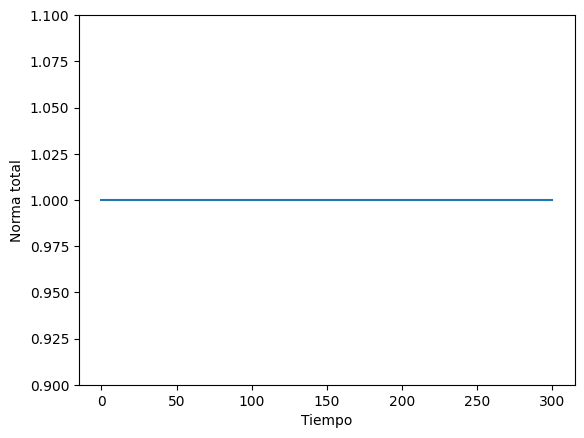

In [37]:
plt.plot(times_polonio, norms_polonio)
plt.xlabel('Tiempo')
plt.ylabel('Norma total')
plt.ylim([0.9, 1.1])       # Ajusta el rango para resaltar la norma alrededor de 1
plt.ticklabel_format(style='plain')  # Fuerza números “normales”
plt.show()

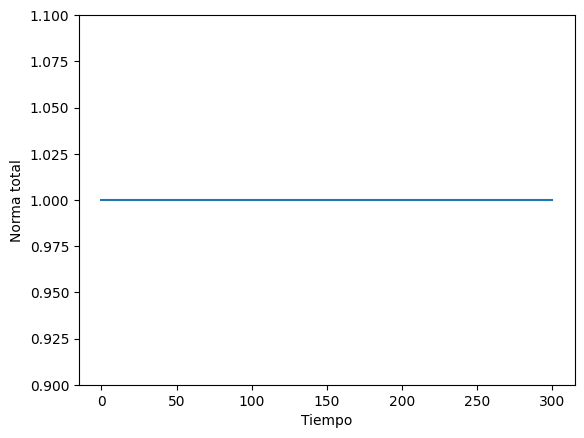

In [38]:
plt.plot(times_uranio, norms_uranio)
plt.xlabel('Tiempo')
plt.ylabel('Norma total')
plt.ylim([0.9, 1.1])       # Ajusta el rango para resaltar la norma alrededor de 1
plt.ticklabel_format(style='plain')  # Fuerza números “normales”
plt.show()

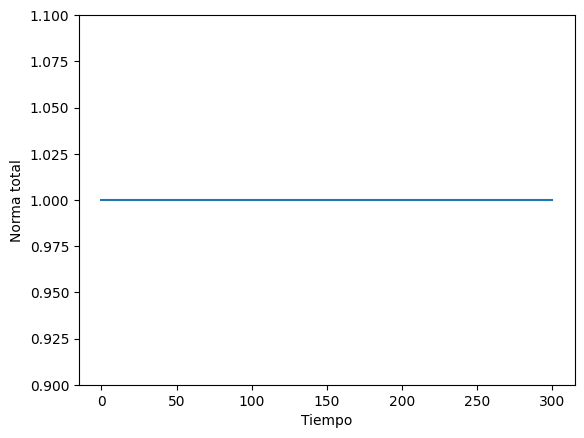

In [39]:
plt.plot(times_actinio, norms_actinio)
plt.xlabel('Tiempo')
plt.ylabel('Norma total')
plt.ylim([0.9, 1.1])       # Ajusta el rango para resaltar la norma alrededor de 1
plt.ticklabel_format(style='plain')  # Fuerza números “normales”
plt.show()

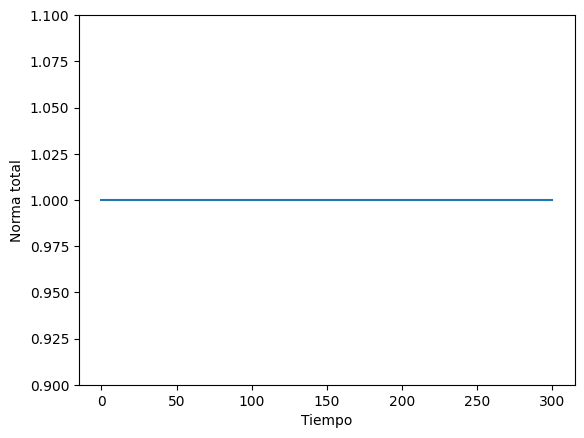

In [40]:
plt.plot(times_radon, norms_radon)
plt.xlabel('Tiempo')
plt.ylabel('Norma total')
plt.ylim([0.9, 1.1])       # Ajusta el rango para resaltar la norma alrededor de 1
plt.ticklabel_format(style='plain')  # Fuerza números “normales”
plt.show()

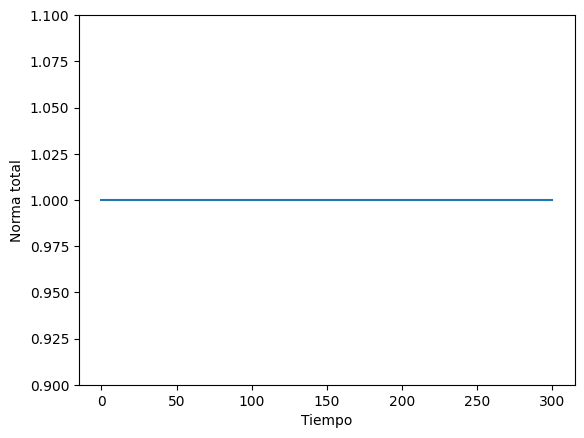

In [41]:
plt.plot(times_polonio2, norms_polonio2)
plt.xlabel('Tiempo')
plt.ylabel('Norma total')
plt.ylim([0.9, 1.1])       # Ajusta el rango para resaltar la norma alrededor de 1
plt.ticklabel_format(style='plain')  # Fuerza números “normales”
plt.show()

Generamos la animación para mostrar la evolución de la función de onda en el tiempo

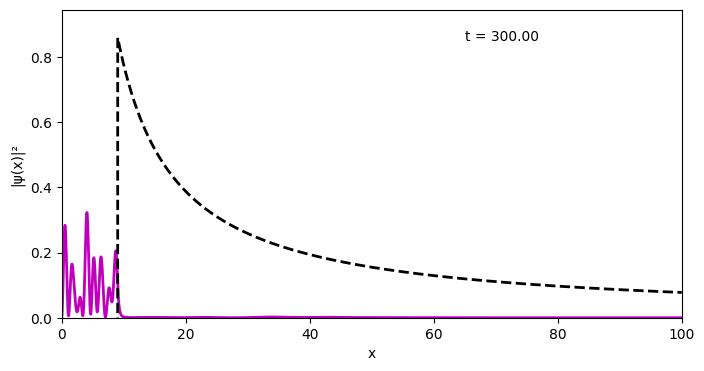

In [42]:
mpl.rcParams['animation.embed_limit'] = 100 * 1024 * 1024  # 100 MB

fig, ax = plt.subplots(figsize=(8, 4))
ln, = ax.plot([], [], 'm-', lw=2)
V_line, = ax.plot([], [], 'k--', lw=2)
time_text = ax.text(0.65, 0.9, '', transform=ax.transAxes)

ax.set_xlim(x[0], x[-1])
ax.set_ylim(0, np.max([np.abs(p)**2 for p in psi_t_polonio])*1.1)
ax.set_xlabel('x')
ax.set_ylabel('|ψ(x)|²')

V_plot = V_polonio / np.max(V_polonio) * np.max([np.abs(p)**2 for p in psi_t_polonio])

def animate(i):
    ln.set_data(x, np.abs(psi_t_polonio[i])**2)
    V_line.set_data(x, V_plot)
    time_text.set_text(f't = {i*dt:.2f}')
    return ln, V_line, time_text

ani = animation.FuncAnimation(fig, animate, frames=len(psi_t_polonio), interval=20, blit=True)
HTML(ani.to_jshtml())


$Q_{alpha}$, Energía de decaimiento de alfa y cálculo de la distancia de corte (posición donde el potencial Coulombiano iguala la energía de decaimiento del alfa)

In [43]:
u_to_MeV = 931.494  # 1 u = 931.494 MeV

# Polonio-212 → Pb-208 + α
M_parent_polonio = 211.988868  # u, masa real de Po-212
M_daughter_polonio = 207.976652 # u, masa real de Pb-208
M_alpha = 4.002603      # u, masa del α

Qalpha_polonio = (M_parent_polonio - M_daughter_polonio - M_alpha) * u_to_MeV
print("Energía de decaimiento (Polonio 212):", Qalpha_polonio, "MeV")

# Uranio-238 → Th-234 + α
M_parent_uranio = 238.050788
M_daughter_uranio = 234.043593
M_alpha_uranio = 4.002603

Qalpha_uranio = (M_parent_uranio - M_daughter_uranio - M_alpha) * u_to_MeV
print("Energía de decaimiento (Uranio 238):", Qalpha_uranio, "MeV")

# Decaimiento alfa: Actinio-227 → Francio-223 + α

M_parent_actinio = 227.0277470  # u, masa de Ac-227
M_daughter_actinio = 223.019735857  # u, masa de Fr-223
M_alpha = 4.002603  # u, masa de la partícula alfa

Qalpha_actinio = (M_parent_actinio - M_daughter_actinio - M_alpha) * u_to_MeV
print("Energía de decaimiento (Actinio 227):", Qalpha_actinio, "MeV")

# Decaimiento alfa: Radón-222 → Polonio-218 + α

M_parent_radon = 222.017570   # u, masa de Rn-222
M_daughter_radon = 218.008973 # u, masa de Po-218
M_alpha = 4.002603             # u, masa de la partícula alfa

Qalpha_radon = (M_parent_radon - M_daughter_radon - M_alpha) * u_to_MeV
print("Energía de decaimiento (Radón 222):", Qalpha_radon, "MeV")

# Decaimiento alfa: Polonio-214 → Plomo-210 + α

M_parent_polonio2 = 218.008973  # u, masa de Po-214 (aproximada)
M_daughter_polonio2 = 213.999805 # u, masa de Pb-210
M_alpha = 4.002603                # u, masa de la partícula alfa

# Cálculo del Q-value
Qalpha_polonio2 = (M_parent_polonio2 - M_daughter_polonio2 - M_alpha) * u_to_MeV
print("Energía de decaimiento (Polonio 214):", Qalpha_polonio2, "MeV")



def Rc(Qalpha, Z, e2=1.44):
    return 2*(Z-2)*e2 / Qalpha

Rc_val_polonio = Rc(Qalpha_polonio, Z_polonio)
Rc_val_uranio = Rc(Qalpha_uranio,Z_uranio)
Rc_val_actinio = Rc(Qalpha_actinio,Z_actinio)
Rc_val_radon = Rc(Qalpha_radon,Z_radon)
Rc_val_polonio2 = Rc(Qalpha_polonio2,Z_polonio2)

idx_Rc_polonio = np.argmin(np.abs(x - Rc_val_polonio))
print("Rc (Polonio) =", Rc_val_polonio, "fm, índice:", idx_Rc_polonio)
idx_Rc_uranio = np.argmin(np.abs(x - Rc_val_uranio))
print("Rc (Uranio) =", Rc_val_uranio, "fm, índice:", idx_Rc_uranio)
idx_Rc_actinio = np.argmin(np.abs(x - Rc_val_actinio))
print("Rc (Actinio) =", Rc_val_actinio, "fm, índice:", idx_Rc_actinio)
idx_Rc_radon = np.argmin(np.abs(x - Rc_val_radon))
print("Rc (Radón) =", Rc_val_radon, "fm, índice:", idx_Rc_radon)
idx_Rc_polonio2 = np.argmin(np.abs(x - Rc_val_polonio2))
print("Rc (Polonio 214) =", Rc_val_polonio2, "fm, índice:", idx_Rc_polonio2)


Energía de decaimiento (Polonio 212): 8.954451821995743 MeV
Energía de decaimiento (Uranio 238): 4.277420448022893 MeV
Energía de decaimiento (Actinio 227): 5.0376527556464765 MeV
Energía de decaimiento (Radón 222): 5.5833750360085315 MeV
Energía de decaimiento (Polonio 214): 6.115258109989388 MeV
Rc (Polonio) = 26.37347374184267 fm, índice: 1318
Rc (Uranio) = 60.59726958097077 fm, índice: 3029
Rc (Actinio) = 49.737449592800665 fm, índice: 2486
Rc (Radón) = 43.32863159644473 fm, índice: 2166
Rc (Polonio 214) = 38.618157361866416 fm, índice: 1931


In [44]:
# -----------------------------
# 2. Lista de energías y k0
# -----------------------------
Ekin_list = [1,2,3,4, 5,6,7,8,9, 10, 11,12,13,14,15,16,17,18,19,20]  # MeV
k0_list_polonio = [np.sqrt(2*mu_polonio*E / hbarc**2) for E in Ekin_list]  # fm^-1
k0_list_uranio = [np.sqrt(2*mu_uranio*E / hbarc**2) for E in Ekin_list]  # fm^-1
k0_list_actinio = [np.sqrt(2*mu_actinio*E / hbarc**2) for E in Ekin_list]  # fm^-1
k0_list_radon = [np.sqrt(2*mu_radon*E / hbarc**2) for E in Ekin_list]  # fm^-1
k0_list_polonio2 = [np.sqrt(2*mu_polonio2*E / hbarc**2) for E in Ekin_list]  # fm^-1


In [45]:
# -----------------------------
# 3. Función para crear paquete de onda inicial
# -----------------------------
def psi0_gauss(x, x0, sigma, k0):
    psi = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)
    psi /= np.sqrt(np.sum(np.abs(psi)**2)*h)  # normalización
    return psi

def psi1_gauss(x, x0, sigma, k0):
    psi = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)
    psi /= np.sqrt(np.sum(np.abs(psi)**2)*h)  # normalización
    return psi

def psi2_gauss(x, x0, sigma, k0):
    psi = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)
    psi /= np.sqrt(np.sum(np.abs(psi)**2)*h)  # normalización
    return psi

def psi3_gauss(x, x0, sigma, k0):
    psi = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)
    psi /= np.sqrt(np.sum(np.abs(psi)**2)*h)  # normalización
    return psi

def psi4_gauss(x, x0, sigma, k0):
    psi = np.exp(-(x-x0)**2/(2*sigma**2)) * np.exp(1j * k0 * x)
    psi /= np.sqrt(np.sum(np.abs(psi)**2)*h)  # normalización
    return psi



In [46]:
Pt_list_polonio = []
x0 = 3.5
sigma = 1.0

for k0, E in zip(k0_list_polonio, Ekin_list):
    # Paquete inicial
    psi = psi0_gauss(x, x0, sigma, k0)
    psi_t_local = [psi.copy()]
    
    # Evolución temporal usando matrices de Polonio
    for n in range(Nt):
        psi = A_lu_polonio.solve(B_polonio.dot(psi))
        psi_t_local.append(psi.copy())
    
    psi_t_local = np.array(psi_t_local)
    
    # Probabilidad de túnel (integral sobre la barrera)
    Pt_per_hit = np.sum(np.abs(psi_t_local[-1, idx_Rc_polonio:])**2) * h
    Pt_list_polonio.append(Pt_per_hit)
    print(f"Polonio: E_kin={E} MeV, P_tunnel={Pt_per_hit:.3e}")


Pt_list_uranio = []
x0 = 3.5
sigma = 1.0

for k0, E in zip(k0_list_uranio, Ekin_list):
    # Paquete inicial
    psi = psi1_gauss(x, x0, sigma, k0)
    psi_t_local = [psi.copy()]
    
    # Evolución temporal usando matrices de Uranio
    for n in range(Nt):
        psi = A_lu_uranio.solve(B_uranio.dot(psi))
        psi_t_local.append(psi.copy())
    
    psi_t_local = np.array(psi_t_local)
    
    # Probabilidad de túnel (integral sobre la barrera)
    Pt_per_hit = np.sum(np.abs(psi_t_local[-1, idx_Rc_uranio:])**2) * h
    Pt_list_uranio.append(Pt_per_hit)
    print(f"Uranio: E_kin={E} MeV, P_tunnel={Pt_per_hit:.3e}")

Pt_list_actinio = []
x0 = 3.5
sigma = 1.0

for k0, E in zip(k0_list_actinio, Ekin_list):
    # Paquete inicial
    psi = psi2_gauss(x, x0, sigma, k0)
    psi_t_local = [psi.copy()]
    
    # Evolución temporal usando matrices de Polonio
    for n in range(Nt):
        psi = A_lu_actinio.solve(B_actinio.dot(psi))
        psi_t_local.append(psi.copy())
    
    psi_t_local = np.array(psi_t_local)
    
    # Probabilidad de túnel (integral sobre la barrera)
    Pt_per_hit = np.sum(np.abs(psi_t_local[-1, idx_Rc_actinio:])**2) * h
    Pt_list_actinio.append(Pt_per_hit)
    print(f"Actinio: E_kin={E} MeV, P_tunnel={Pt_per_hit:.3e}")

Pt_list_radon = []
x0 = 3.5
sigma = 1.0

for k0, E in zip(k0_list_radon, Ekin_list):
    # Paquete inicial
    psi = psi3_gauss(x, x0, sigma, k0)
    psi_t_local = [psi.copy()]
    
    # Evolución temporal usando matrices de Radón
    for n in range(Nt):
        psi = A_lu_radon.solve(B_radon.dot(psi))
        psi_t_local.append(psi.copy())
    
    psi_t_local = np.array(psi_t_local)
    
    # Probabilidad de túnel (integral sobre la barrera)
    Pt_per_hit = np.sum(np.abs(psi_t_local[-1, idx_Rc_radon:])**2) * h
    Pt_list_radon.append(Pt_per_hit)
    print(f"Radon-222: E_kin={E} MeV, P_tunnel={Pt_per_hit:.3e}")


Pt_list_polonio2 = []
x0 = 3.5
sigma = 1.0

for k0, E in zip(k0_list_polonio2, Ekin_list):
    # Paquete inicial
    psi = psi4_gauss(x, x0, sigma, k0)
    psi_t_local = [psi.copy()]
    
    # Evolución temporal usando matrices de Polonio
    for n in range(Nt):
        psi = A_lu_polonio2.solve(B_polonio2.dot(psi))
        psi_t_local.append(psi.copy())
    
    psi_t_local = np.array(psi_t_local)
    
    # Probabilidad de túnel (integral sobre la barrera)
    Pt_per_hit = np.sum(np.abs(psi_t_local[-1, idx_Rc_polonio2:])**2) * h
    Pt_list_polonio2.append(Pt_per_hit)
    print(f"Polonio: E_kin={E} MeV, P_tunnel={Pt_per_hit:.3e}")





Polonio: E_kin=1 MeV, P_tunnel=1.059e-06
Polonio: E_kin=2 MeV, P_tunnel=2.893e-06
Polonio: E_kin=3 MeV, P_tunnel=6.795e-06
Polonio: E_kin=4 MeV, P_tunnel=1.405e-05
Polonio: E_kin=5 MeV, P_tunnel=2.633e-05
Polonio: E_kin=6 MeV, P_tunnel=4.576e-05
Polonio: E_kin=7 MeV, P_tunnel=7.496e-05
Polonio: E_kin=8 MeV, P_tunnel=1.171e-04
Polonio: E_kin=9 MeV, P_tunnel=1.759e-04
Polonio: E_kin=10 MeV, P_tunnel=2.559e-04
Polonio: E_kin=11 MeV, P_tunnel=3.620e-04
Polonio: E_kin=12 MeV, P_tunnel=5.000e-04
Polonio: E_kin=13 MeV, P_tunnel=6.766e-04
Polonio: E_kin=14 MeV, P_tunnel=8.989e-04
Polonio: E_kin=15 MeV, P_tunnel=1.175e-03
Polonio: E_kin=16 MeV, P_tunnel=1.514e-03
Polonio: E_kin=17 MeV, P_tunnel=1.925e-03
Polonio: E_kin=18 MeV, P_tunnel=2.418e-03
Polonio: E_kin=19 MeV, P_tunnel=3.005e-03
Polonio: E_kin=20 MeV, P_tunnel=3.697e-03
Uranio: E_kin=1 MeV, P_tunnel=1.423e-07
Uranio: E_kin=2 MeV, P_tunnel=1.446e-07
Uranio: E_kin=3 MeV, P_tunnel=1.523e-07
Uranio: E_kin=4 MeV, P_tunnel=1.677e-07
Uranio: E

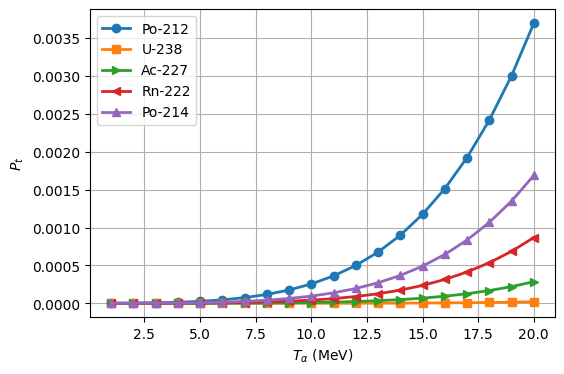

In [47]:
plt.figure(figsize=(6,4))

# Polonio-212
plt.plot(Ekin_list, Pt_list_polonio, 'o-', lw=2, label='Po-212')

# Uranio-238
plt.plot(Ekin_list, Pt_list_uranio, 's-', lw=2, label='U-238')

# Actinio-227
plt.plot(Ekin_list, Pt_list_actinio, '>-', lw=2, label='Ac-227')

# Radón-222
plt.plot(Ekin_list, Pt_list_radon, '<-', lw=2, label='Rn-222')

# Polonio-212
plt.plot(Ekin_list, Pt_list_polonio2, '^-', lw=2, label='Po-214')

plt.xlabel(r'$T_{\alpha}$ (MeV)')
plt.ylabel(r'$P_t$')
plt.legend()
plt.grid(True)
plt.show()


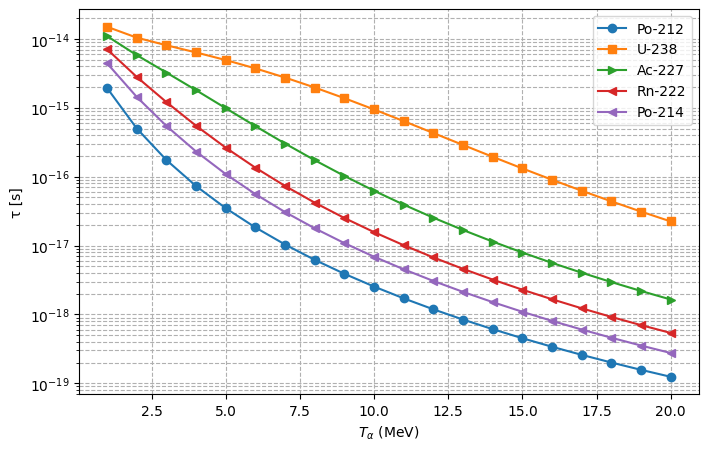

In [48]:
# Constantes
m_alpha = 6.644e-27       # kg
eV_to_J = 1.602e-13       # 1 MeV = 1.602e-13 J
R0 = 1.2e-15               # m

# Datos nucleares
A_polonio = 210
A_uranio = 238
A_actinio = 227
A_radon = 222
A_polonio2 = 218

R_polonio = R0 * A_polonio**(1/3)
R_uranio = R0 * A_uranio**(1/3)
R_actinio = R0 * A_actinio**(1/3)
R_radon = R0 * A_radon**(1/3)
R_polonio2 = R0 * A_polonio2**(1/3)

# Función para calcular vida media
def calcular_tau(Pt_list, E_list, R_nuc):
    tau_list = []
    for Pt, E_MeV in zip(Pt_list, E_list):
        E_J = E_MeV * eV_to_J
        v_alpha = np.sqrt(2 * E_J / m_alpha)
        f = v_alpha / (2 * R_nuc)
        tau = 1 / (f * Pt)
        tau_list.append(tau)
    return np.array(tau_list)

# Calcular vidas medias
tau_polonio = calcular_tau(Pt_list_polonio, Ekin_list, R_polonio)
tau_uranio = calcular_tau(Pt_list_uranio, Ekin_list, R_uranio)
tau_actinio = calcular_tau(Pt_list_actinio, Ekin_list, R_actinio)
tau_radon = calcular_tau(Pt_list_radon, Ekin_list, R_radon)
tau_polonio2 = calcular_tau(Pt_list_polonio2, Ekin_list, R_polonio2)

# Graficar
plt.figure(figsize=(8,5))
plt.semilogy(Ekin_list, tau_polonio, 'o-', label='Po-212')
plt.semilogy(Ekin_list, tau_uranio, 's-', label='U-238')
plt.semilogy(Ekin_list, tau_actinio, '>-', label='Ac-227')
plt.semilogy(Ekin_list, tau_radon, '<-', label='Rn-222')
plt.semilogy(Ekin_list, tau_polonio2, '<-', label='Po-214')
plt.xlabel(r'$T_{\alpha}$ (MeV)')
plt.ylabel('τ [s]')
plt.grid(True, which="both", ls="--")
plt.legend()
plt.show()